1.ANALISE EXPLORATORIA DA BASE DE REGISTROS DE OBSERVAÇÕES DO JWST

In [1]:
import dask.dataframe as dd

file_path = 'sample_data/jw02731_20230622t075023_pool.csv'

# Especifique manualmente os tipos de dados para os campos problemáticos
dtype = {
    'CHANNEL': 'object',
    'MODULE': 'object',
    'PATTSTRT': 'float64',
    'PUPIL': 'object'
}

# Carregue o arquivo CSV com tipos de dados especificados
data = dd.read_csv(file_path, sep="|", dtype=dtype)


In [2]:
!pip install dask

In [3]:
data

,FILENAME,OBS_ID,PROGRAM,OBS_NUM,VISIT,VISIT_ID,VISITGRP,VISITYPE,SEQ_ID,ACT_ID,EXPOSURE,EXP_TYPE,NEXPOSUR,EXPCOUNT,INSTRUME,DETECTOR,CHANNEL,TARGETID,TARGPROP,TARGNAME,TARGTYPE,TEMPLATE,PNTGTYPE,PNTG_SEQ,TARGORDN,EXPSPCIN,DITHPTIN,MOSTILNO,MODULE,FILTER,PUPIL,DITHERID,PATTTYPE,PATTSTRT,NUMDTHPT,PATTSIZE,SUBPXPTS,PATT_NUM,SUBPIXEL,APERNAME,SDP_VER,SUBARRAY,GRATING,FXD_SLIT,BAND,GWA_XTIL,GWA_YTIL,ASN_CANDIDATE,EXPOSERR,IS_PSF,IS_IMPRT,BKGDTARG,TSOVISIT,MSASTATE,MSAMETFL,OPMODE,LAMP,SPEC_NUM,SPAT_NUM,DMS_NOTE,EXSEGTOT
npartitions=1,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
,object,object,int64,int64,int64,int64,int64,object,int64,int64,int64,object,int64,int64,object,object,object,int64,object,object,object,object,object,int64,int64,int64,int64,int64,object,object,object,int64,object,float64,int64,object,float64,int64,float64,object,object,object,float64,float64,float64,float64,float64,object,float64,float64,float64,object,object,float64,float64,float64,object,float64,float64,float64,float64
,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


RESUMO ESTATÍSTICO

In [4]:
# Substitua os valores 'não numerico' por 'NaN' na coluna 'NEXPOSUR' e converta a coluna para float
data['NEXPOSUR'] = data['NEXPOSUR'].map(lambda x: float('NaN') if x == 'não numerico' else float(x))

# Calcule os percentis para "NEXPOSUR"
nexposur_percentiles = data['NEXPOSUR'].quantile([0.25, 0.50, 0.75]).compute()

print("Estatísticas descritivas para NEXPOSUR:")
print(nexposur_percentiles)

Estatísticas descritivas para NEXPOSUR:
0.25    15.0
0.50    15.0
0.75    15.0
Name: NEXPOSUR, dtype: float64


1.1 DISTRIBUIÇÃO DE TIPOS DE EXPOSIÇÃO:

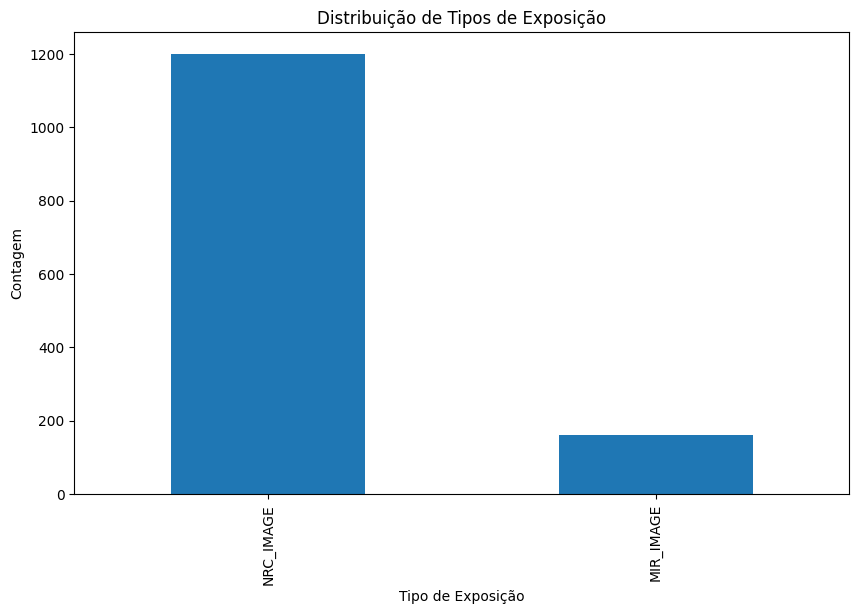

In [5]:
import matplotlib.pyplot as plt

# Calcule a contagem de ocorrências de cada tipo de exposição (EXP_TYPE)
exposure_counts = data['EXP_TYPE'].value_counts()

# Visualize a distribuição usando um gráfico de barras
exposure_counts.compute().plot(kind='bar', figsize=(10, 6))
plt.title('Distribuição de Tipos de Exposição')
plt.xlabel('Tipo de Exposição')
plt.ylabel('Contagem')
plt.show()

1.2 ANÁLISE DE ALVOS

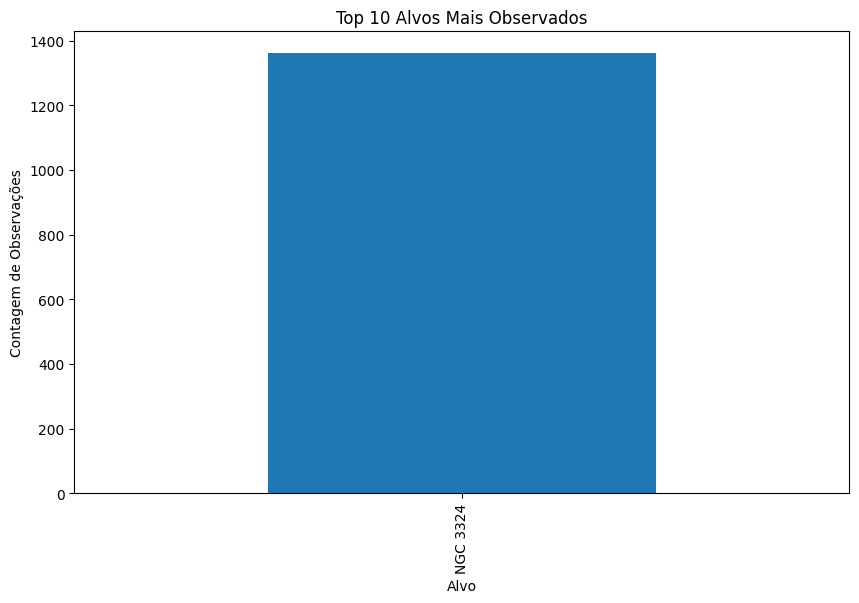

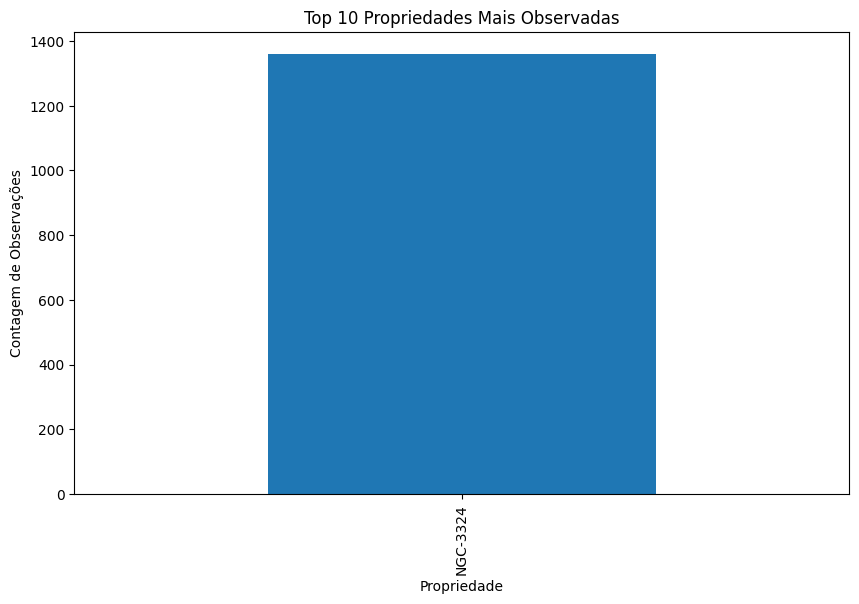

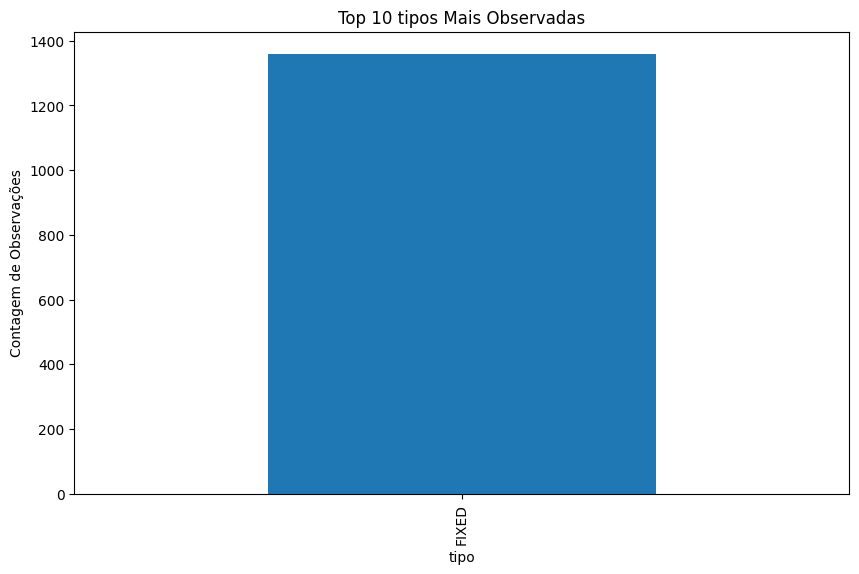

In [6]:
# Agrupe os dados por TARGNAME e conte as observações para cada alvo
target_counts = data.groupby('TARGNAME')['OBS_ID'].count()

# Ordene os alvos por contagem em ordem decrescente para identificar os mais observados
top_targets = target_counts.compute().sort_values(ascending=False)

# Visualize os alvos mais observados
top_targets[:10].plot(kind='bar', figsize=(10, 6))
plt.title('Top 10 Alvos Mais Observados')
plt.xlabel('Alvo')
plt.ylabel('Contagem de Observações')
plt.show()

# Para as propriedades associadas aos alvos, você pode fazer o mesmo tipo de análise
# Agrupe os dados por TARGPROP e conte as observações para cada propriedade
prop_counts = data.groupby('TARGPROP')['OBS_ID'].count()

# Ordene as propriedades por contagem em ordem decrescente
top_props = prop_counts.compute().sort_values(ascending=False)

# Visualize as propriedades mais observadas
top_props[:10].plot(kind='bar', figsize=(10, 6))
plt.title('Top 10 Propriedades Mais Observadas')
plt.xlabel('Propriedade')
plt.ylabel('Contagem de Observações')
plt.show()

prop_counts = data.groupby('TARGTYPE')['OBS_ID'].count()

# Ordene as propriedades por contagem em ordem decrescente
top_props = prop_counts.compute().sort_values(ascending=False)

# Visualize as propriedades mais observadas
top_props[:10].plot(kind='bar', figsize=(10, 6))
plt.title('Top 10 tipos Mais Observadas')
plt.xlabel('tipo')
plt.ylabel('Contagem de Observações')
plt.show()

1.3 ANÁLISE DE FILTROS E BANDAS:

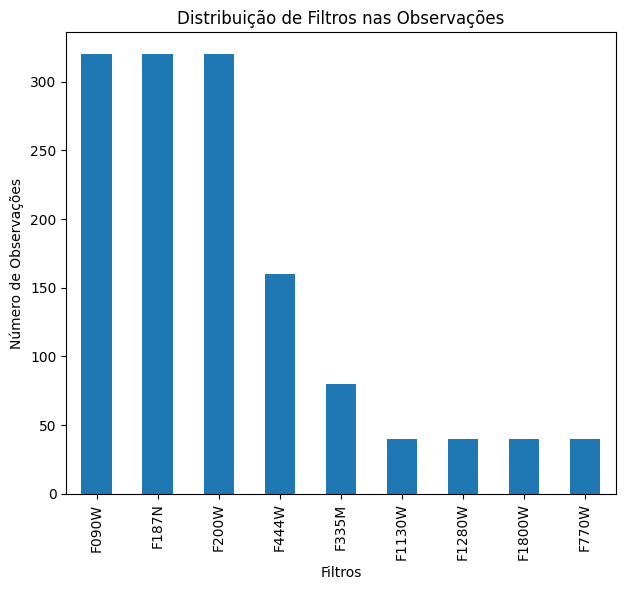

In [7]:
# Filtrar as colunas relevantes (FILTER e BAND)
filtered_data = data[['FILTER', 'BAND']]

# Calcular a contagem de filtros
filter_counts = filtered_data['FILTER'].value_counts().compute()

# Calcular a contagem de bandas (caso aplicável)
band_counts = filtered_data['BAND'].value_counts().compute()

# Plotar gráficos de barras para a distribuição de filtros e bandas
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
filter_counts.plot(kind='bar')
plt.title('Distribuição de Filtros nas Observações')
plt.xlabel('Filtros')
plt.ylabel('Número de Observações')

if not band_counts.empty:
    plt.subplot(1, 2, 2)
    band_counts.plot(kind='bar')
    plt.title('Distribuição de Bandas nas Observações')
    plt.xlabel('Bandas')
    plt.ylabel('Número de Observações')

plt.tight_layout()
plt.show()


1.4 MOSÁICO VS NÃO MOSÁICO:

In [8]:
# Crie uma coluna 'MOSAICO' com valores True para observações de mosaico e False para não mosaico
data['MOSAICO'] = data['MOSTILNO'] == 1  # ou outro valor numérico que indique "mosaic"

In [9]:
# Contagem de observações de mosaico e não mosaico
count_mosaico = data['MOSAICO'].sum().compute()
count_nao_mosaico = len(data) - count_mosaico

In [10]:
# Comparação de configurações entre observações de mosaico e não mosaico
mosaico_data = data[data['MOSAICO'] == True]
nao_mosaico_data = data[data['MOSAICO'] == False]

# Exemplos de análises de configurações
mosaico_filter_counts = mosaico_data['FILTER'].value_counts().compute()
nao_mosaico_filter_counts = nao_mosaico_data['FILTER'].value_counts().compute()


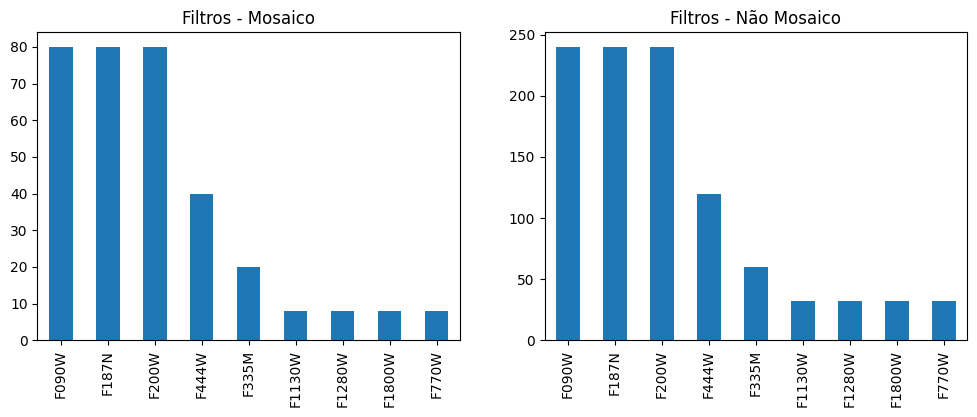

In [11]:
# Crie gráficos para visualizar a distribuição de observações de mosaico e não mosaico
fig, ax = plt.subplots(1, 2, figsize=(12, 4))

mosaico_filter_counts.plot(kind='bar', ax=ax[0], title='Filtros - Mosaico')
nao_mosaico_filter_counts.plot(kind='bar', ax=ax[1], title='Filtros - Não Mosaico')

plt.show()


1.5 ANÁLISE DE PADRÕES DE OBSERVAÇÃO:

> Indented block



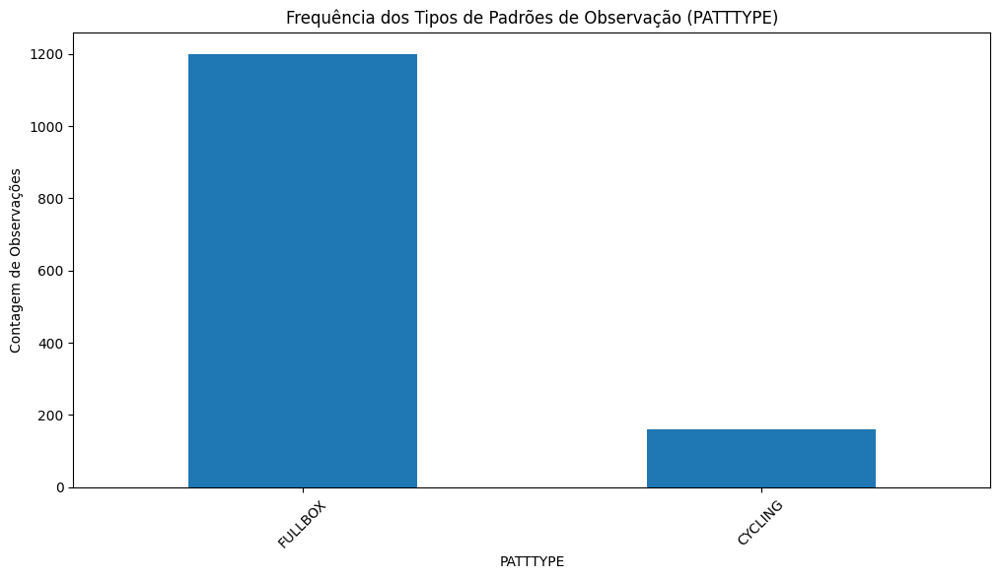

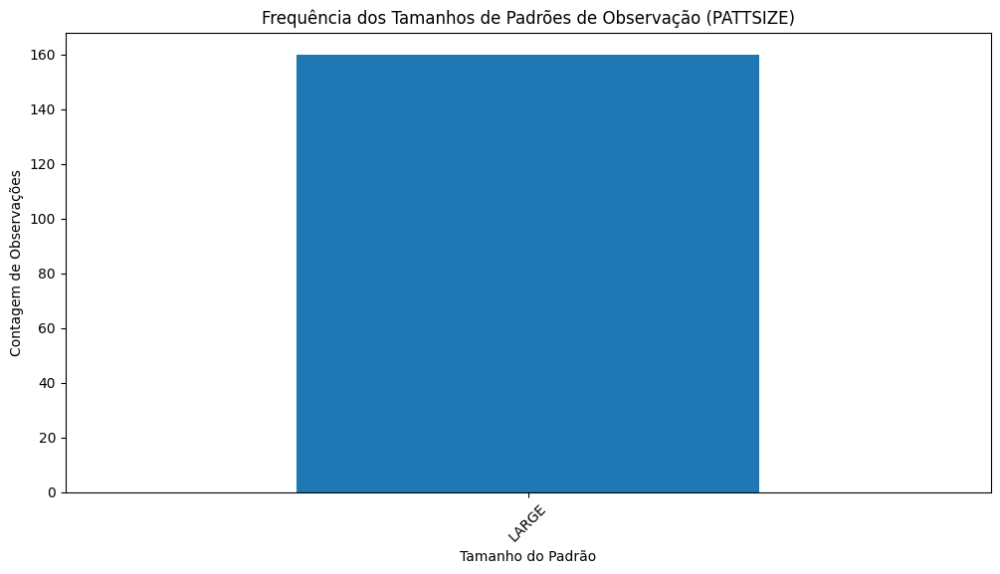

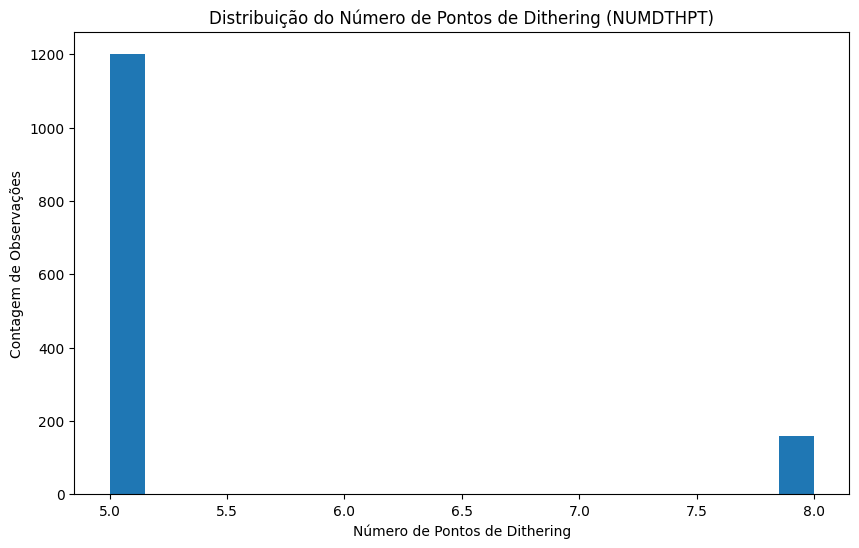

In [12]:
# Etapa 1: Contagem de Padrões (PATTTYPE)
pattern_counts = data['PATTTYPE'].value_counts().compute()

# Etapa 2: Gráfico de Barras (PATTTYPE)
plt.figure(figsize=(12, 6))
pattern_counts.plot(kind='bar')
plt.title('Frequência dos Tipos de Padrões de Observação (PATTTYPE)')
plt.xlabel('PATTTYPE')
plt.ylabel('Contagem de Observações')
plt.xticks(rotation=45)
plt.show()

# Etapa 3: Análise de Tamanho do Padrão (PATTSIZE)
pattsize_counts = data['PATTSIZE'].value_counts().compute()

# Etapa 4: Gráfico de Distribuição (PATTSIZE)
plt.figure(figsize=(12, 6))
pattsize_counts.plot(kind='bar')
plt.title('Frequência dos Tamanhos de Padrões de Observação (PATTSIZE)')
plt.xlabel('Tamanho do Padrão')
plt.ylabel('Contagem de Observações')
plt.xticks(rotation=45)
plt.show()

# Etapa 5: Análise de Pontos de Dithering (NUMDTHPT)
dithering_stats = data['NUMDTHPT'].describe().compute()

# Etapa 6: Gráfico de Distribuição (NUMDTHPT)
plt.figure(figsize=(10, 6))
data['NUMDTHPT'].compute().plot(kind='hist', bins=20)
plt.title('Distribuição do Número de Pontos de Dithering (NUMDTHPT)')
plt.xlabel('Número de Pontos de Dithering')
plt.ylabel('Contagem de Observações')
plt.show()


1.6 ANÁLISE DE INSTRUMENTOS:

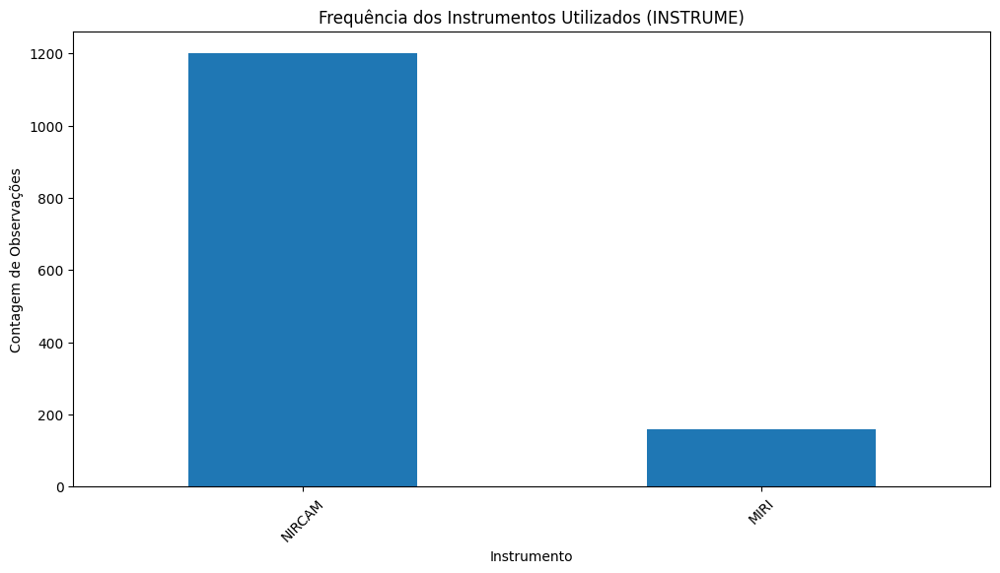

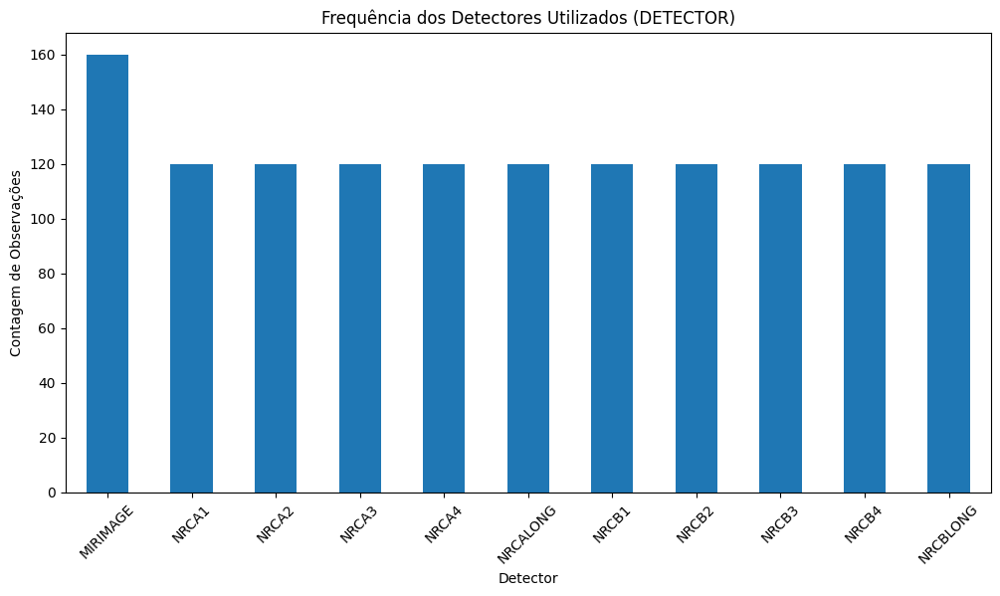

In [13]:
# Etapa 1: Contagem de Instrumentos e Detectores
instrument_counts = data['INSTRUME'].value_counts().compute()
detector_counts = data['DETECTOR'].value_counts().compute()

# Etapa 2: Gráfico de Barras para Instrumentos
plt.figure(figsize=(12, 6))
instrument_counts.plot(kind='bar')
plt.title('Frequência dos Instrumentos Utilizados (INSTRUME)')
plt.xlabel('Instrumento')
plt.ylabel('Contagem de Observações')
plt.xticks(rotation=45)
plt.show()

# Etapa 3: Gráfico de Barras para Detectores
plt.figure(figsize=(12, 6))
detector_counts.plot(kind='bar')
plt.title('Frequência dos Detectores Utilizados (DETECTOR)')
plt.xlabel('Detector')
plt.ylabel('Contagem de Observações')
plt.xticks(rotation=45)
plt.show()


1.7 ASSOCIAÇÃO DE CANDIDATOS:

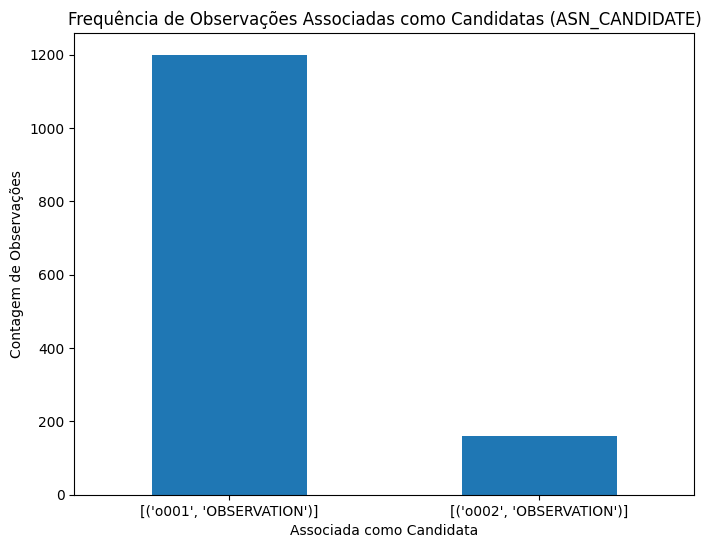

In [14]:
# Importe as bibliotecas necessárias
import matplotlib.pyplot as plt

# Etapa 1: Contagem de Observações Associadas como Candidatas
candidate_counts = data['ASN_CANDIDATE'].value_counts().compute()

# Etapa 2: Gráfico de Barras para Observações Associadas como Candidatas
plt.figure(figsize=(8, 6))
candidate_counts.plot(kind='bar')
plt.title('Frequência de Observações Associadas como Candidatas (ASN_CANDIDATE)')
plt.xlabel('Associada como Candidata')
plt.ylabel('Contagem de Observações')
plt.xticks(rotation=0)
plt.show()


1.8 TSO (TEMPO DE OBSERVAÇÃO ESPECÍFICO):

In [15]:
# Etapa 1: Filtrar observações TSOVISIT
tso_observations = data[data['TSOVISIT'] == 'T']

# Etapa 2: Verificar quais colunas estão presentes nas observações TSOVISIT
tso_columns = ['EXPOSURE', 'BAND', 'FXD_SLIT']
tso_configurations = tso_observations[tso_columns]

# Etapa 3: Verificar se há dados nas colunas
if not tso_configurations.compute().empty:
    # Etapa 4: Resumo Estatístico das configurações
    tso_configurations_summary = tso_configurations.describe().compute()

    # Etapa 5: Visualização das configurações
    print("Resumo Estatístico das Configurações de Observações TSOVISIT:")
    print(tso_configurations_summary)

    # Etapa 6: Contagem de configurações únicas
    unique_configurations = tso_configurations.apply(lambda x: ', '.join(x.dropna().astype(str)), axis=1).value_counts().compute()

    # Etapa 7: Gráfico de Barras para Contagem de Configurações Únicas
    plt.figure(figsize=(12, 8))
    unique_configurations.plot(kind='bar')
    plt.title('Contagem de Configurações Únicas em Observações TSOVISIT')
    plt.xlabel('Configuração Única')
    plt.ylabel('Contagem de Observações')
    plt.xticks(rotation=90)
    plt.show()
else:
    print("Não há dados disponíveis nas colunas de configurações em Observações TSOVISIT.")


Não há dados disponíveis nas colunas de configurações em Observações TSOVISIT.


1.9 ERROS DE EXPOSIÇÃO (EXPOSERR):

In [16]:
data['EXPOSERR'] = data['EXPOSERR'].fillna(0)


In [17]:
data = data.dropna(subset=['EXPOSERR'])


In [18]:
import dask.dataframe as dd

# Verificar se a coluna contém apenas valores numéricos
meta = ('EXPOSERR', 'float64')  # Defina o tipo de saída esperado
data['EXPOSERR'] = data['EXPOSERR'].apply(dd.to_numeric, errors='coerce', meta=meta)

# Remover linhas com valores não numéricos
data = data.dropna(subset=['EXPOSERR'])


In [19]:
import os

os.environ["DASK_SCHEDULER"] = "tcp://127.0.0.1:8788"  # Use uma porta diferente

In [20]:
import dask.dataframe as dd

# Substitua os valores nulos por 0 na coluna 'exposerr'
data['EXPOSERR'] = data['EXPOSERR'].fillna(0)

# Conte quantos valores iguais a 0 existem na coluna 'exposerr'
count_zeros_exposerr = (data['EXPOSERR'] == 0).sum().compute()

# Exiba o resultado
print(f"Quantidade de valores iguais a 0 na coluna 'EXPOSERR': {count_zeros_exposerr}")

# Usando len()
num_rows = len(data)

# Ou usando shape
num_rows = data.shape[0].compute()

# Exibindo o resultado
print(f"Número de linhas no DataFrame: {num_rows}")



Quantidade de valores iguais a 0 na coluna 'EXPOSERR': 0
Número de linhas no DataFrame: 1360


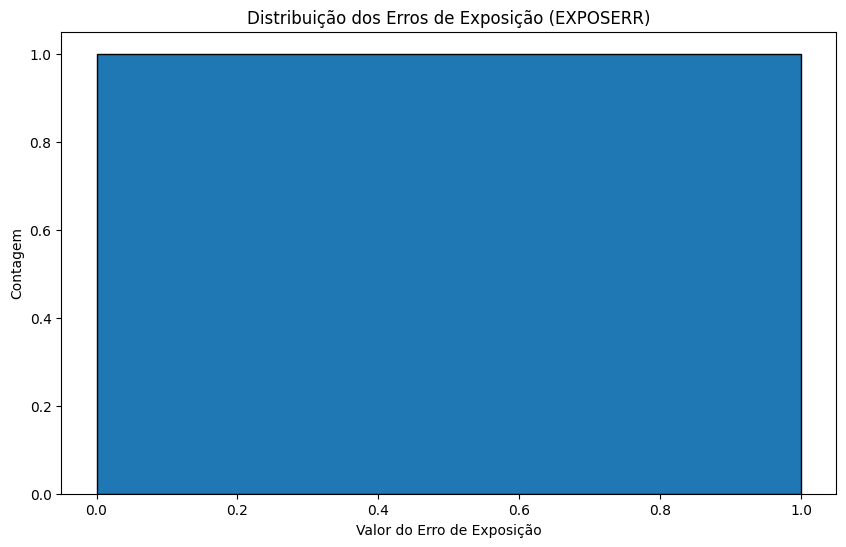

In [21]:
import matplotlib.pyplot as plt
import dask.array as da
import numpy as np

# Crie um array Dask com um único valor (0)
exposerr_array = da.from_array([0], chunks=(1,))

# Calcule o histograma usando Dask Array
hist, bin_edges = da.histogram(exposerr_array, bins=[0, 1])

# Calcule os resultados ao mesmo tempo usando da.compute
hist_np, bin_edges_np = da.compute(hist, bin_edges)

# Calcule os centros das barras para o plot
bin_centers = (bin_edges_np[:-1] + bin_edges_np[1:]) / 2

# Plotar o histograma usando matplotlib
plt.figure(figsize=(10, 6))
plt.bar(bin_centers, hist_np, width=bin_edges_np[1] - bin_edges_np[0], edgecolor='black')
plt.title('Distribuição dos Erros de Exposição (EXPOSERR)')
plt.xlabel('Valor do Erro de Exposição')
plt.ylabel('Contagem')
plt.show()


In [22]:
#Verificação dos valores únicos:
unique_values = data['EXPOSERR'].unique().compute()
print("Valores únicos em EXPOSERR:", unique_values)


Valores únicos em EXPOSERR: 0       Delayed('to_numeric-ff6dc419a25a3a224f528c6b90...
1       Delayed('to_numeric-ff6dc419a25a3a224f528c6b90...
2       Delayed('to_numeric-ff6dc419a25a3a224f528c6b90...
3       Delayed('to_numeric-ff6dc419a25a3a224f528c6b90...
4       Delayed('to_numeric-ff6dc419a25a3a224f528c6b90...
                              ...                        
1355    Delayed('to_numeric-ff6dc419a25a3a224f528c6b90...
1356    Delayed('to_numeric-ff6dc419a25a3a224f528c6b90...
1357    Delayed('to_numeric-ff6dc419a25a3a224f528c6b90...
1358    Delayed('to_numeric-ff6dc419a25a3a224f528c6b90...
1359    Delayed('to_numeric-ff6dc419a25a3a224f528c6b90...
Name: EXPOSERR, Length: 1360, dtype: object


In [23]:
pip install dask-ml

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 148.7/148.7 kB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 7.3 MB/s eta 0:00:00


In [24]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from dask_ml.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

X = data
y = X['EXPOSURE']

# Lista de colunas categóricas
categorical_columns = ['FILENAME', 'OBS_ID', 'PROGRAM', 'OBS_NUM', 'VISIT', 'VISIT_ID', 'VISITGRP', 'VISITYPE',
                        'SEQ_ID', 'ACT_ID', 'EXPOSURE', 'NEXPOSUR', 'EXPCOUNT', 'INSTRUME', 'DETECTOR',
                        'CHANNEL', 'TARGETID', 'TARGPROP', 'TARGNAME', 'TARGTYPE', 'TEMPLATE', 'PNTGTYPE', 'PNTG_SEQ',
                        'TARGORDN', 'EXPSPCIN', 'DITHPTIN', 'MOSTILNO', 'MODULE', 'FILTER', 'PUPIL', 'DITHERID',
                        'PATTTYPE', 'PATTSTRT', 'NUMDTHPT', 'PATTSIZE', 'SUBPXPTS', 'PATT_NUM', 'SUBPIXEL', 'APERNAME',
                        'SDP_VER', 'SUBARRAY', 'GRATING', 'FXD_SLIT', 'BAND', 'GWA_XTIL', 'GWA_YTIL', 'ASN_CANDIDATE',
                        'EXPOSERR', 'IS_PSF', 'IS_IMPRT', 'BKGDTARG', 'TSOVISIT', 'MSASTATE', 'MSAMETFL', 'OPMODE',
                        'LAMP', 'SPEC_NUM', 'SPAT_NUM', 'DMS_NOTE', 'EXSEGTOT', 'EXP_TYPE']

# 1. Aplicar codificação one-hot nas colunas categóricas, incluindo EXP_TYPE
X_encoded = pd.get_dummies(X.compute(), columns=categorical_columns, dummy_na=True)

# 2. Divisão dos dados em treinamento e teste
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y.compute(), test_size=0.2, random_state=42)

# 3. Treinamento do modelo
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# 4. Avaliação do modelo
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Acurácia do modelo:", accuracy)

Acurácia do modelo: 1.0


In [31]:
pip install python-multipart

In [30]:
pip install kaleido

In [32]:
pip install google-colab

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 7.5 MB/s eta 0:00:00


In [29]:
pip install uvicorn

In [33]:
pip install bigframes

In [28]:
pip install fastapi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 92.1/92.1 kB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.5/71.5 kB 7.9 MB/s eta 0:00:00


In [34]:
pip install statsmodels

In [35]:
pip install pandas==2.1.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.7/12.7 MB 23.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 345.4/345.4 kB 22.0 MB/s eta 0:00:00
  Attempting uninstall: pandas
    Found existing installation: pandas 1.5.3
    Uninstalling pandas-1.5.3:
      Successfully uninstalled pandas-1.5.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires pandas==1.5.3, but you have pandas 2.1.0 which is incompatible.
statsmodels 0.14.1 requires pandas!=2.1.0,>=1.0, but you have pandas 2.1.0 which is incompatible.


1.10 ESTIMANDO OS DADOS COM RANDOM FOREST

In [36]:
import dask
import dask.dataframe as dd
from dask_ml.preprocessing import LabelEncoder
from dask_ml.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.ensemble import RandomForestClassifier
from dask_ml.wrappers import ParallelPostFit
import pandas as pd

# Etapa 1: Codificar os rótulos
encoder = LabelEncoder()
y_encoded = encoder.fit_transform(y)

# Etapa 2: Divisão dos dados
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42, convert_mixed_types=True)

# Etapa 3: Converter Dask Array para Dask DataFrame
X_train_df = dd.from_dask_array(X_train, columns=X.columns)
X_test_df = dd.from_dask_array(X_test, columns=X.columns)

# Substituir os valores desconhecidos por um valor específico, como 'unknown'
unknown_value = 'unknown'

# Função de substituição
def replace_unknown(val):
    return unknown_value if pd.isna(val) else str(val)

# Aplicar a função de substituição a todas as colunas
X_train_df = X_train_df.applymap(replace_unknown)
X_test_df = X_test_df.applymap(replace_unknown)

# Garantir que as colunas sejam categóricas
X_train_df = X_train_df.categorize(columns=X_train_df.columns)
X_test_df = X_test_df.categorize(columns=X_test_df.columns)

# Garantir que ambas as dataframes tenham as mesmas categorias
common_categories = X_train_df.columns.astype('category').categories

# Certifique-se de que ambas as dataframes tenham as mesmas categorias
X_test_df = X_test_df.astype({col: 'category' for col in X_test_df.columns}).astype({col: 'category' for col in common_categories})

# Ajustar as categorias do conjunto de teste para serem iguais ao conjunto de treinamento
for col in common_categories:
    X_test_df[col] = X_test_df[col].cat.set_categories(X_train_df[col].cat.categories)

# Inicializar o OneHotEncoder
onehot_encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')

# Ajustar e transformar os dados apenas com o conjunto de treinamento
X_train_encoded = onehot_encoder.fit_transform(X_train_df.compute())

# Aplicar o mesmo transformador ao conjunto de teste
X_test_encoded = onehot_encoder.transform(X_test_df.compute())

# Criar DataFrames Dask com os nomes das colunas
X_train_encoded_df = dd.from_pandas(pd.DataFrame(X_train_encoded, columns=onehot_encoder.get_feature_names_out(X_train_df.columns)), npartitions=4)
X_test_encoded_df = dd.from_pandas(pd.DataFrame(X_test_encoded, columns=onehot_encoder.get_feature_names_out(X_train_df.columns)), npartitions=4)

# Declare o modelo base (Random Forest neste exemplo)
base_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Envolver o modelo base no ParallelPostFit para permitir predições paralelas
parallel_model = ParallelPostFit(base_model)

# Treinar o modelo nos dados de treinamento
parallel_model.fit(X_train_encoded_df, y_train.compute())

# Certifique-se de que X_test_df é um Dask DataFrame
X_test_df = dd.from_dask_array(X_test, columns=X.columns)

# Etapa 8: Avaliação do modelo
X_test_computed = X_test_df.compute()
y_test_computed = y_test.compute()
y_pred = parallel_model.predict(X_test_encoded_df)
y_pred_computed = y_pred.compute()  # Certifique-se de que a computação foi realizada
print(f'Dimensões de y_pred: {y_pred_computed.shape}')
print(f'Dimensões de y_test_computed: {y_test_computed.shape}')

# Verifique se há valores nan em y_pred ou y_test_computed
nan_in_y_pred = dask.compute(dask.array.isnan(y_pred_computed).any())[0]
nan_in_y_test = dask.compute(dask.array.isnan(y_test_computed).any())[0]

if nan_in_y_pred or nan_in_y_test:
    raise ValueError("Os arrays contêm valores nan. Lide com isso antes de comparar.")

# Agora você pode realizar a comparação
accuracy = (y_pred_computed == y_test_computed).mean()
print(f"Acurácia do modelo: {accuracy:.2f}")



/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


Dimensões de y_pred: (272,)
Dimensões de y_test_computed: (272,)
Acurácia do modelo: 1.00


2 INICIANDO ANALISE ASTROPY PARA VERIFICAR IMAGENS DO TELESCÓPIO.

2.1 VERIFICANDO ARQUIVO DE IMAGEM

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
from astropy.io import fits
jwst = fits.open('drive/MyDrive/jw02731-o001_t017_nircam_clear-f090w_segm.fits')

jwst.info()


Filename: drive/MyDrive/jw02731-o001_t017_nircam_clear-f090w_segm.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     375   ()      
  1  SCI           1 ImageHDU        31   (14215, 8421)   int32 (rescales to uint32)   
  2  ASDF          1 BinTableHDU     11   1R x 1C   [11878B]   


In [39]:
header = jwst[1].header
print('Header Information')
header


Header Information


XTENSION= 'IMAGE   '           / Image extension                                
BITPIX  =                   32 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                14215                                                  
NAXIS2  =                 8421                                                  
PCOUNT  =                    0 / number of parameters                           
GCOUNT  =                    1 / number of groups                               
BSCALE  =                    1                                                  
BZERO   =           2147483648                                                  
EXTNAME = 'SCI     '           / extension name                                 
                                                                                
        WCS parameters                                                          
                            

In [3]:
data = jwst[1].data
data

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint32)

In [4]:
import numpy as np

np.shape(data)

(8421, 14215)

2.2 PLOTANDO IMAGEM COM PIXEL

In [42]:
from google.colab import output
output.enable_custom_widget_manager()

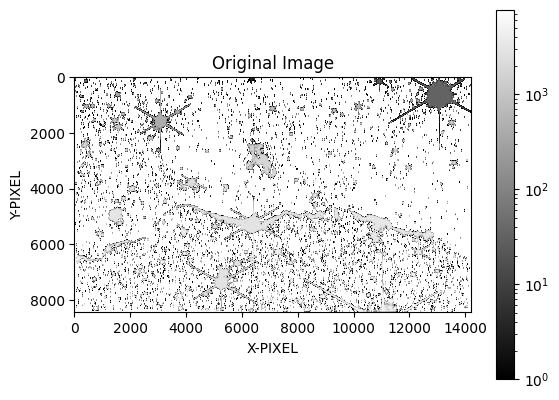

In [43]:
from matplotlib.colors import LogNorm
import matplotlib.pyplot as plt

plt.figure()
plt.imshow(data, norm=LogNorm(), cmap='gray')
plt.ylabel('Y-PIXEL')
plt.xlabel('X-PIXEL')
plt.colorbar()
plt.title('Original Image')
plt.show()

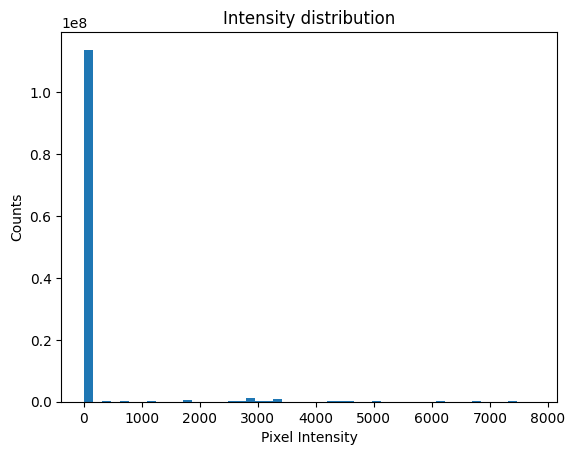

In [44]:
#Intensity distribution
plt.figure()
plt.hist(np.ravel(data),bins=50)
plt.title('Intensity distribution')
plt.ylabel('Counts')
plt.xlabel('Pixel Intensity')
plt.show()

Support for third party widgets will remain active for the duration of the session. To disable support:

2.3 PLOT FITS IMAGE IN WCS COORDINATE

In [45]:
from astropy.wcs import WCS
wcs=WCS(jwst[1].header)
wcs

WCS Keywords

Number of WCS axes: 2
CTYPE : 'RA---TAN'  'DEC--TAN'  
CRVAL : 159.2127246212098  -58.6204409329473  
CRPIX : 7107.741615279159  4217.28891642306  
PC1_1 PC1_2  : 0.2297799212945406  0.9732426150605381  
PC2_1 PC2_2  : 0.9732426150605381  -0.2297799212945406  
CDELT : 8.7129950883333e-06  8.7129950883333e-06  
NAXIS : 14215  8421

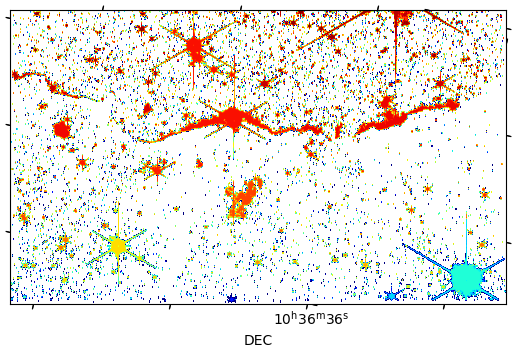

In [46]:
plt.figure()
plt.subplot(projection=wcs)
plt.imshow(data,norm=LogNorm(),cmap='jet')
plt.ylabel('RA')
plt.xlabel('DEC')

In [5]:

# Configurar o contexto temporal - Supondo múltiplas imagens temporais
num_temporal_slices = 10
temporal_data = np.array([data[i:i+num_temporal_slices] for i in range(len(data)-num_temporal_slices+1)])

# Preparar dados para LSTM
X = temporal_data[:, :-1]  # Entradas temporais
X

array([[[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       ...,

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 

In [6]:
y = temporal_data[:, 1:]   # Saídas temporais
y

array([[[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       ...,

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 

In [7]:
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

# Suponha que você tenha 100 sequências de comprimento 9 com 14215 características cada
X_train = np.random.rand(100, 9, 14215)
# Suponha que você tenha 100 sequências de comprimento 9, cada uma com um valor alvo
y_train = np.random.rand(100, 9, 1)

# Reduzir o tamanho do conjunto de treinamento (por exemplo, 80%)
X_train_small, _, y_train_small, _ = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

# Reshape para o formato adequado para LSTM (amostras, tempo, recursos)
X_train_small = X_train_small.reshape(X_train_small.shape[0], X_train_small.shape[1], 14215)
y_train_small = y_train_small.reshape(y_train_small.shape[0], y_train_small.shape[1], 1)

# Definir modelo LSTM com menos unidades
model = Sequential()
model.add(LSTM(32, input_shape=(X_train_small.shape[1], X_train_small.shape[2]), return_sequences=True))
model.add(Dense(1))

# Compilar modelo
model.compile(optimizer='adam', loss='mean_squared_error')

# Treinar o modelo
history = model.fit(X_train_small, y_train_small, epochs=10, batch_size=1, verbose=1)

final_learning_rate = model.optimizer.learning_rate.numpy()
print(f'Taxa de Aprendizado Final: {final_learning_rate}')


Epoch 1/10
80/80 [==============================] - 6s 56ms/step - loss: 2.2458
Epoch 2/10
80/80 [==============================] - 5s 67ms/step - loss: 0.5666
Epoch 3/10
80/80 [==============================] - 4s 51ms/step - loss: 0.1532
Epoch 4/10
80/80 [==============================] - 4s 54ms/step - loss: 0.0914
Epoch 5/10
80/80 [==============================] - 5s 67ms/step - loss: 0.0863
Epoch 6/10
80/80 [==============================] - 4s 54ms/step - loss: 0.0860
Epoch 7/10
80/80 [==============================] - 6s 77ms/step - loss: 0.0860
Epoch 8/10
80/80 [==============================] - 5s 63ms/step - loss: 0.0861
Epoch 9/10
80/80 [==============================] - 4s 55ms/step - loss: 0.0863
Epoch 10/10
80/80 [==============================] - 5s 62ms/step - loss: 0.0861
Taxa de Aprendizado Final: 0.0010000000474974513


2.4 MODELO DE ÁRVORE DE DECISÃO

In [50]:
## Liberando Variaveis que irei recriar
%reset_selective -f model
%reset_selective -f X_train
%reset_selective -f X_test
%reset_selective -f y_train
%reset_selective -f y_test

In [51]:
from sklearn.model_selection import train_test_split

# Reduzir ainda mais o tamanho do conjunto de treinamento (por exemplo, 10%)
X_train, X_test, y_train, y_test = train_test_split(X[:, :1, :], y, test_size=0.1, random_state=42)

In [52]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, classification_report
import numpy as np

# Reshape para o formato adequado para árvore de decisão (amostras, recursos)
X_train_flatten = X_train.reshape(X_train.shape[0], -1)
X_test_flatten = X_test.reshape(X_test.shape[0], -1)

# Achatando os rótulos (y_train) para torná-los unidimensionais
y_train_flat = y_train.reshape(-1)

# Escolher aleatoriamente um subconjunto dos dados de treinamento
subset_size = 1000  # Escolha o tamanho do subconjunto conforme necessário
subset_size = min(subset_size, len(X_train_flatten))  # Evitar escolher mais do que o disponível

random_indices = np.random.choice(len(X_train_flatten), subset_size, replace=False)

X_train_subset = X_train_flatten[random_indices]
y_train_subset = y_train_flat[random_indices]

# Criar e treinar o modelo de árvore de decisão
dt_model = DecisionTreeClassifier(random_state=42)
dt_model.fit(X_train_subset, y_train_subset)

# Achatando os rótulos de teste para torná-los unidimensionais
y_test_flat = y_test.reshape(-1)

# Escolher aleatoriamente um subconjunto dos dados de teste
subset_size_test = min(subset_size, len(X_test_flatten))

random_indices_test = np.random.choice(len(X_test_flatten), subset_size_test, replace=False)

X_test_subset = X_test_flatten[random_indices_test]
y_test_subset = y_test_flat[random_indices_test]

# Fazer previsões por lotes usando predict
batch_predictions = []

batch_size = 100
for i in range(0, len(X_test_subset), batch_size):
    end = i + batch_size if i + batch_size < len(X_test_subset) else len(X_test_subset)
    batch_predictions.extend(dt_model.predict(X_test_subset[i:end]))

# Avaliar o desempenho
accuracy_dt = accuracy_score(y_test_subset, batch_predictions)
print(f'Acurácia do Modelo de Árvore de Decisão: {accuracy_dt:.2f}')

# Relatório de Classificação
print(classification_report(y_test_subset, batch_predictions, zero_division=1))


Acurácia do Modelo de Árvore de Decisão: 0.95
              precision    recall  f1-score   support

           0       1.00      0.95      0.97       842
        2927       0.00      1.00      0.00         0
        5694       0.00      1.00      0.00         0
        5699       0.00      1.00      0.00         0
        5701       0.00      1.00      0.00         0
        5706       0.00      1.00      0.00         0

    accuracy                           0.95       842
   macro avg       0.17      0.99      0.16       842
weighted avg       1.00      0.95      0.97       842



In [54]:
%reset -f

2.5 DESCOBRIDO CAMPOS DE ESTRELA E PLANETAS APENAS COM ANALISE DE IMAGEM.

In [6]:
from skimage import color, segmentation
import matplotlib.pyplot as plt

# Normalizar os dados entre 0 e 1
normalized_data = (data - data.min()) / (data.max() - data.min())

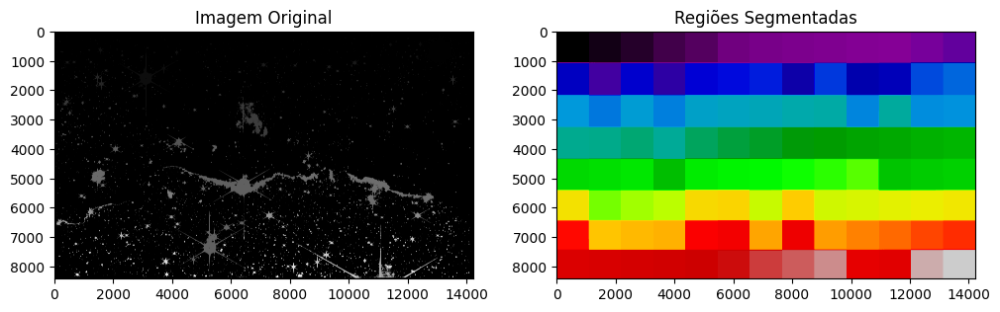

In [7]:
# Aplicar a segmentação SLIC
segments = segmentation.slic(normalized_data, n_segments=100, compactness=10)

# Exibir a imagem original e as regiões segmentadas
fig, ax = plt.subplots(1, 2, figsize=(12, 6))

ax[0].imshow(normalized_data, cmap='gray')
ax[0].set_title('Imagem Original')

ax[1].imshow(segments, cmap='nipy_spectral')
ax[1].set_title('Regiões Segmentadas')

plt.show()

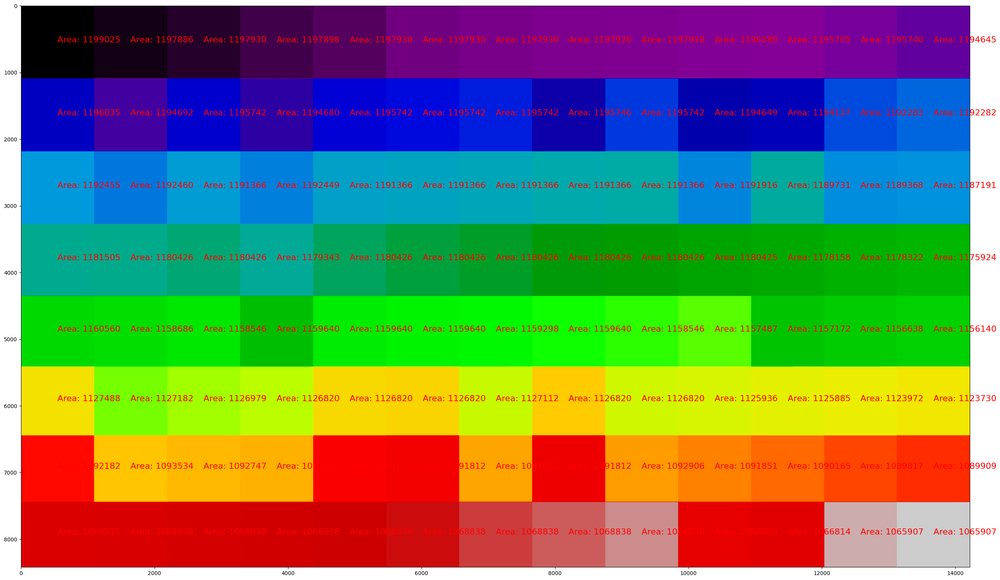

In [7]:
from skimage.measure import regionprops, label

# Aplicar a segmentação SLIC (se não tiver feito ainda)
segments = segmentation.slic(normalized_data, n_segments=100, compactness=10)

# Rotular as regiões segmentadas
labeled_segments = label(segments)

# Calcular propriedades das regiões
props = regionprops(labeled_segments, intensity_image=normalized_data)

# Exemplo: Visualizar as regiões com suas áreas
fig, ax = plt.subplots(figsize=(32, 32))
ax.imshow(labeled_segments, cmap='nipy_spectral')

for prop in props:
    # Filtrar regiões por área (ajuste conforme necessário)
    if prop.area > 100:
        y, x = prop.centroid
        ax.text(x, y, f'Area: {prop.area}', color='red', fontsize=16)

plt.show()


In [8]:
pip install opencv-python

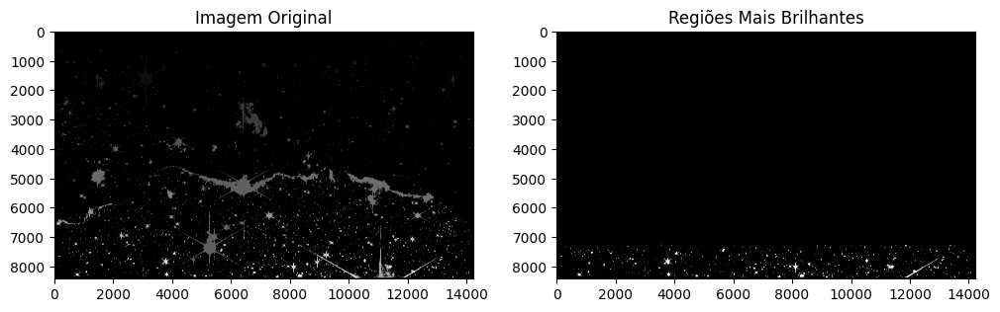

In [8]:
import cv2

# Normalizar os dados entre 0 e 1
normalized_data = (data - data.min()) / (data.max() - data.min())

# Carregar a imagem original (normalized_data)
# Certifique-se de que normalized_data seja a imagem original normalizada
# (se você precisar da imagem original, substitua normalized_data pelo nome correto da variável)
img = normalized_data

# Aplicar um filtro de brilho para destacar regiões mais brilhantes
_, bright_regions = cv2.threshold(img, 0.8, 1, cv2.THRESH_BINARY)

# Exibir a imagem original e as regiões mais brilhantes
fig, ax = plt.subplots(1, 2, figsize=(12, 6))

ax[0].imshow(img, cmap='gray')
ax[0].set_title('Imagem Original')

ax[1].imshow(bright_regions, cmap='gray')
ax[1].set_title('Regiões Mais Brilhantes')

plt.show()

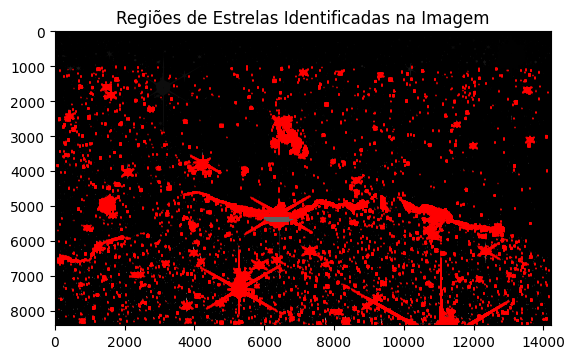

Streaming output truncated to the last 5000 lines.
Região 186: Número de pixels = 16, Coordenadas = [(6483, 1032), (6484, 1032), (6485, 1032), (6486, 1032), (6487, 1032), (6488, 1032), (6489, 1032), (6490, 1032), (6491, 1032), (6492, 1032), (6493, 1032), (6494, 1032), (6495, 1032), (6496, 1032), (6497, 1032), (6498, 1032)]
Região 187: Número de pixels = 19, Coordenadas = [(1226, 1033), (1227, 1033), (1228, 1033), (1229, 1033), (1230, 1033), (1231, 1033), (1232, 1033), (1233, 1033), (1234, 1033), (1235, 1033), (1236, 1033), (1237, 1033), (1238, 1033), (1239, 1033), (1240, 1033), (1241, 1033), (1242, 1033), (1243, 1033), (1244, 1033)]
Região 188: Número de pixels = 19, Coordenadas = [(1333, 1033), (1334, 1033), (1335, 1033), (1336, 1033), (1337, 1033), (1338, 1033), (1339, 1033), (1340, 1033), (1341, 1033), (1342, 1033), (1343, 1033), (1344, 1033), (1345, 1033), (1346, 1033), (1347, 1033), (1348, 1033), (1349, 1033), (1350, 1033), (1351, 1033)]
Região 189: Número de pixels = 32, Coordena

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Região 12708: Número de pixels = 38, Coordenadas = [(558, 2710), (559, 2710), (560, 2710), (561, 2710), (562, 2710), (563, 2710), (564, 2710), (565, 2710), (566, 2710), (567, 2710), (568, 2710), (569, 2710), (570, 2710), (571, 2710), (572, 2710), (573, 2710), (574, 2710), (575, 2710), (576, 2710), (577, 2710), (578, 2710), (579, 2710), (580, 2710), (581, 2710), (582, 2710), (583, 2710), (584, 2710), (585, 2710), (586, 2710), (587, 2710), (588, 2710), (589, 2710), (590, 2710), (591, 2710), (592, 2710), (593, 2710), (594, 2710), (595, 2710)]
Região 12709: Número de pixels = 11, Coordenadas = [(2436, 2710), (2437, 2710), (2438, 2710), (2439, 2710), (2440, 2710), (2441, 2710), (2442, 2710), (2443, 2710), (2444, 2710), (2445, 2710), (2446, 2710)]
Região 12710: Número de pixels = 41, Coordenadas = [(2475, 2710), (2476, 2710), (2477, 2710), (2478, 2710), (2479, 2710), (2480, 2710), (2481, 2710), (2482, 2710), (2483, 2710), (2484, 2710), (2485, 2710), (2486, 2710), (2487, 2710), (2488, 2710), 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Região 24657: Número de pixels = 27, Coordenadas = [(2062, 3942), (2063, 3942), (2064, 3942), (2065, 3942), (2066, 3942), (2067, 3942), (2068, 3942), (2069, 3942), (2070, 3942), (2071, 3942), (2072, 3942), (2073, 3942), (2074, 3942), (2075, 3942), (2076, 3942), (2077, 3942), (2078, 3942), (2079, 3942), (2080, 3942), (2081, 3942), (2082, 3942), (2083, 3942), (2084, 3942), (2085, 3942), (2086, 3942), (2087, 3942), (2088, 3942)]
Região 24658: Número de pixels = 16, Coordenadas = [(2224, 3942), (2225, 3942), (2226, 3942), (2227, 3942), (2228, 3942), (2229, 3942), (2230, 3942), (2231, 3942), (2232, 3942), (2233, 3942), (2234, 3942), (2235, 3942), (2236, 3942), (2237, 3942), (2238, 3942), (2239, 3942)]
Região 24659: Número de pixels = 10, Coordenadas = [(2959, 3942), (2960, 3942), (2961, 3942), (2962, 3942), (2963, 3942), (2964, 3942), (2965, 3942), (2966, 3942), (2967, 3942), (2968, 3942)]
Região 24660: Número de pixels = 34, Coordenadas = [(3882, 3942), (3883, 3942), (3884, 3942), (3885, 3

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Região 31648: Número de pixels = 23, Coordenadas = [(4394, 4797), (4395, 4797), (4396, 4797), (4397, 4797), (4398, 4797), (4399, 4797), (4400, 4797), (4401, 4797), (4402, 4797), (4403, 4797), (4404, 4797), (4405, 4797), (4406, 4797), (4407, 4797), (4408, 4797), (4409, 4797), (4410, 4797), (4411, 4797), (4412, 4797), (4413, 4797), (4414, 4797), (4415, 4797), (4416, 4797)]
Região 31649: Número de pixels = 40, Coordenadas = [(4531, 4797), (4532, 4797), (4533, 4797), (4534, 4797), (4535, 4797), (4536, 4797), (4537, 4797), (4538, 4797), (4539, 4797), (4540, 4797), (4541, 4797), (4542, 4797), (4543, 4797), (4544, 4797), (4545, 4797), (4546, 4797), (4547, 4797), (4548, 4797), (4549, 4797), (4550, 4797), (4551, 4797), (4552, 4797), (4553, 4797), (4554, 4797), (4555, 4797), (4556, 4797), (4557, 4797), (4558, 4797), (4559, 4797), (4560, 4797), (4561, 4797), (4562, 4797), (4563, 4797), (4564, 4797), (4565, 4797), (4566, 4797), (4567, 4797), (4568, 4797), (4569, 4797), (4570, 4797)]
Região 31650:

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Região 37625: Número de pixels = 28, Coordenadas = [(9455, 5062), (9456, 5062), (9457, 5062), (9458, 5062), (9459, 5062), (9460, 5062), (9461, 5062), (9462, 5062), (9463, 5062), (9464, 5062), (9465, 5062), (9466, 5062), (9467, 5062), (9468, 5062), (9469, 5062), (9470, 5062), (9471, 5062), (9472, 5062), (9473, 5062), (9474, 5062), (9475, 5062), (9476, 5062), (9477, 5062), (9478, 5062), (9479, 5062), (9480, 5062), (9481, 5062), (9482, 5062)]
Região 37626: Número de pixels = 57, Coordenadas = [(10052, 5062), (10053, 5062), (10054, 5062), (10055, 5062), (10056, 5062), (10057, 5062), (10058, 5062), (10059, 5062), (10060, 5062), (10061, 5062), (10062, 5062), (10063, 5062), (10064, 5062), (10065, 5062), (10066, 5062), (10067, 5062), (10068, 5062), (10069, 5062), (10070, 5062), (10071, 5062), (10072, 5062), (10073, 5062), (10074, 5062), (10075, 5062), (10076, 5062), (10077, 5062), (10078, 5062), (10079, 5062), (10080, 5062), (10081, 5062), (10082, 5062), (10083, 5062), (10084, 5062), (10085, 5

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Região 40627: Número de pixels = 19, Coordenadas = [(9458, 5174), (9459, 5174), (9460, 5174), (9461, 5174), (9462, 5174), (9463, 5174), (9464, 5174), (9465, 5174), (9466, 5174), (9467, 5174), (9468, 5174), (9469, 5174), (9470, 5174), (9471, 5174), (9472, 5174), (9473, 5174), (9474, 5174), (9475, 5174), (9476, 5174)]
Região 40628: Número de pixels = 16, Coordenadas = [(10130, 5174), (10131, 5174), (10132, 5174), (10133, 5174), (10134, 5174), (10135, 5174), (10136, 5174), (10137, 5174), (10138, 5174), (10139, 5174), (10140, 5174), (10141, 5174), (10142, 5174), (10143, 5174), (10144, 5174), (10145, 5174)]
Região 40629: Número de pixels = 39, Coordenadas = [(10376, 5174), (10377, 5174), (10378, 5174), (10379, 5174), (10380, 5174), (10381, 5174), (10382, 5174), (10383, 5174), (10384, 5174), (10385, 5174), (10386, 5174), (10387, 5174), (10388, 5174), (10389, 5174), (10390, 5174), (10391, 5174), (10392, 5174), (10393, 5174), (10394, 5174), (10395, 5174), (10396, 5174), (10397, 5174), (10398,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Região 43474: Número de pixels = 11, Coordenadas = [(3761, 5316), (3762, 5316), (3763, 5316), (3764, 5316), (3765, 5316), (3766, 5316), (3767, 5316), (3768, 5316), (3769, 5316), (3770, 5316), (3771, 5316)]
Região 43475: Número de pixels = 25, Coordenadas = [(3882, 5316), (3883, 5316), (3884, 5316), (3885, 5316), (3886, 5316), (3887, 5316), (3888, 5316), (3889, 5316), (3890, 5316), (3891, 5316), (3892, 5316), (3893, 5316), (3894, 5316), (3895, 5316), (3896, 5316), (3897, 5316), (3898, 5316), (3899, 5316), (3900, 5316), (3901, 5316), (3902, 5316), (3903, 5316), (3904, 5316), (3905, 5316), (3906, 5316)]
Região 43476: Número de pixels = 19, Coordenadas = [(4941, 5316), (4942, 5316), (4943, 5316), (4944, 5316), (4945, 5316), (4946, 5316), (4947, 5316), (4948, 5316), (4949, 5316), (4950, 5316), (4951, 5316), (4952, 5316), (4953, 5316), (4954, 5316), (4955, 5316), (4956, 5316), (4957, 5316), (4958, 5316), (4959, 5316)]
Região 43477: Número de pixels = 32, Coordenadas = [(5031, 5316), (5032, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Região 46163: Número de pixels = 15, Coordenadas = [(10791, 5461), (10792, 5461), (10793, 5461), (10794, 5461), (10795, 5461), (10796, 5461), (10797, 5461), (10798, 5461), (10799, 5461), (10800, 5461), (10801, 5461), (10802, 5461), (10803, 5461), (10804, 5461), (10805, 5461)]
Região 46164: Número de pixels = 100, Coordenadas = [(10814, 5461), (10815, 5461), (10816, 5461), (10817, 5461), (10818, 5461), (10819, 5461), (10820, 5461), (10821, 5461), (10822, 5461), (10823, 5461), (10824, 5461), (10825, 5461), (10826, 5461), (10827, 5461), (10828, 5461), (10829, 5461), (10830, 5461), (10831, 5461), (10832, 5461), (10833, 5461), (10834, 5461), (10835, 5461), (10836, 5461), (10837, 5461), (10838, 5461), (10839, 5461), (10840, 5461), (10841, 5461), (10842, 5461), (10843, 5461), (10844, 5461), (10845, 5461), (10846, 5461), (10847, 5461), (10848, 5461), (10849, 5461), (10850, 5461), (10851, 5461), (10852, 5461), (10853, 5461), (10854, 5461), (10855, 5461), (10856, 5461), (10857, 5461), (10858, 54

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Região 49843: Número de pixels = 17, Coordenadas = [(9485, 5622), (9486, 5622), (9487, 5622), (9488, 5622), (9489, 5622), (9490, 5622), (9491, 5622), (9492, 5622), (9493, 5622), (9494, 5622), (9495, 5622), (9496, 5622), (9497, 5622), (9498, 5622), (9499, 5622), (9500, 5622), (9501, 5622)]
Região 49844: Número de pixels = 24, Coordenadas = [(10583, 5622), (10584, 5622), (10585, 5622), (10586, 5622), (10587, 5622), (10588, 5622), (10589, 5622), (10590, 5622), (10591, 5622), (10592, 5622), (10593, 5622), (10594, 5622), (10595, 5622), (10596, 5622), (10597, 5622), (10598, 5622), (10599, 5622), (10600, 5622), (10601, 5622), (10602, 5622), (10603, 5622), (10604, 5622), (10605, 5622), (10606, 5622)]
Região 49845: Número de pixels = 153, Coordenadas = [(10664, 5622), (10665, 5622), (10666, 5622), (10667, 5622), (10668, 5622), (10669, 5622), (10670, 5622), (10671, 5622), (10672, 5622), (10673, 5622), (10674, 5622), (10675, 5622), (10676, 5622), (10677, 5622), (10678, 5622), (10679, 5622), (106

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Região 54805: Número de pixels = 11, Coordenadas = [(1758, 5915), (1759, 5915), (1760, 5915), (1761, 5915), (1762, 5915), (1763, 5915), (1764, 5915), (1765, 5915), (1766, 5915), (1767, 5915), (1768, 5915)]
Região 54806: Número de pixels = 69, Coordenadas = [(1782, 5915), (1783, 5915), (1784, 5915), (1785, 5915), (1786, 5915), (1787, 5915), (1788, 5915), (1789, 5915), (1790, 5915), (1791, 5915), (1792, 5915), (1793, 5915), (1794, 5915), (1795, 5915), (1796, 5915), (1797, 5915), (1798, 5915), (1799, 5915), (1800, 5915), (1801, 5915), (1802, 5915), (1803, 5915), (1804, 5915), (1805, 5915), (1806, 5915), (1807, 5915), (1808, 5915), (1809, 5915), (1810, 5915), (1811, 5915), (1812, 5915), (1813, 5915), (1814, 5915), (1815, 5915), (1816, 5915), (1817, 5915), (1818, 5915), (1819, 5915), (1820, 5915), (1821, 5915), (1822, 5915), (1823, 5915), (1824, 5915), (1825, 5915), (1826, 5915), (1827, 5915), (1828, 5915), (1829, 5915), (1830, 5915), (1831, 5915), (1832, 5915), (1833, 5915), (1834, 5915),

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Região 61411: Número de pixels = 13, Coordenadas = [(9021, 6337), (9022, 6337), (9023, 6337), (9024, 6337), (9025, 6337), (9026, 6337), (9027, 6337), (9028, 6337), (9029, 6337), (9030, 6337), (9031, 6337), (9032, 6337), (9033, 6337)]
Região 61412: Número de pixels = 51, Coordenadas = [(9976, 6337), (9977, 6337), (9978, 6337), (9979, 6337), (9980, 6337), (9981, 6337), (9982, 6337), (9983, 6337), (9984, 6337), (9985, 6337), (9986, 6337), (9987, 6337), (9988, 6337), (9989, 6337), (9990, 6337), (9991, 6337), (9992, 6337), (9993, 6337), (9994, 6337), (9995, 6337), (9996, 6337), (9997, 6337), (9998, 6337), (9999, 6337), (10000, 6337), (10001, 6337), (10002, 6337), (10003, 6337), (10004, 6337), (10005, 6337), (10006, 6337), (10007, 6337), (10008, 6337), (10009, 6337), (10010, 6337), (10011, 6337), (10012, 6337), (10013, 6337), (10014, 6337), (10015, 6337), (10016, 6337), (10017, 6337), (10018, 6337), (10019, 6337), (10020, 6337), (10021, 6337), (10022, 6337), (10023, 6337), (10024, 6337), (10

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Região 65977: Número de pixels = 92, Coordenadas = [(4126, 6554), (4127, 6554), (4128, 6554), (4129, 6554), (4130, 6554), (4131, 6554), (4132, 6554), (4133, 6554), (4134, 6554), (4135, 6554), (4136, 6554), (4137, 6554), (4138, 6554), (4139, 6554), (4140, 6554), (4141, 6554), (4142, 6554), (4143, 6554), (4144, 6554), (4145, 6554), (4146, 6554), (4147, 6554), (4148, 6554), (4149, 6554), (4150, 6554), (4151, 6554), (4152, 6554), (4153, 6554), (4154, 6554), (4155, 6554), (4156, 6554), (4157, 6554), (4158, 6554), (4159, 6554), (4160, 6554), (4161, 6554), (4162, 6554), (4163, 6554), (4164, 6554), (4165, 6554), (4166, 6554), (4167, 6554), (4168, 6554), (4169, 6554), (4170, 6554), (4171, 6554), (4172, 6554), (4173, 6554), (4174, 6554), (4175, 6554), (4176, 6554), (4177, 6554), (4178, 6554), (4179, 6554), (4180, 6554), (4181, 6554), (4182, 6554), (4183, 6554), (4184, 6554), (4185, 6554), (4186, 6554), (4187, 6554), (4188, 6554), (4189, 6554), (4190, 6554), (4191, 6554), (4192, 6554), (4193, 65

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Região 73242: Número de pixels = 11, Coordenadas = [(344, 6935), (345, 6935), (346, 6935), (347, 6935), (348, 6935), (349, 6935), (350, 6935), (351, 6935), (352, 6935), (353, 6935), (354, 6935)]
Região 73243: Número de pixels = 12, Coordenadas = [(399, 6935), (400, 6935), (401, 6935), (402, 6935), (403, 6935), (404, 6935), (405, 6935), (406, 6935), (407, 6935), (408, 6935), (409, 6935), (410, 6935)]
Região 73244: Número de pixels = 124, Coordenadas = [(2210, 6935), (2211, 6935), (2212, 6935), (2213, 6935), (2214, 6935), (2215, 6935), (2216, 6935), (2217, 6935), (2218, 6935), (2219, 6935), (2220, 6935), (2221, 6935), (2222, 6935), (2223, 6935), (2224, 6935), (2225, 6935), (2226, 6935), (2227, 6935), (2228, 6935), (2229, 6935), (2230, 6935), (2231, 6935), (2232, 6935), (2233, 6935), (2234, 6935), (2235, 6935), (2236, 6935), (2237, 6935), (2238, 6935), (2239, 6935), (2240, 6935), (2241, 6935), (2242, 6935), (2243, 6935), (2244, 6935), (2245, 6935), (2246, 6935), (2247, 6935), (2248, 6935

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Região 81711: Número de pixels = 409, Coordenadas = [(5069, 7461), (5070, 7461), (5071, 7461), (5072, 7461), (5073, 7461), (5074, 7461), (5075, 7461), (5076, 7461), (5077, 7461), (5078, 7461), (5079, 7461), (5080, 7461), (5081, 7461), (5082, 7461), (5083, 7461), (5084, 7461), (5085, 7461), (5086, 7461), (5087, 7461), (5088, 7461), (5089, 7461), (5090, 7461), (5091, 7461), (5092, 7461), (5093, 7461), (5094, 7461), (5095, 7461), (5096, 7461), (5097, 7461), (5098, 7461), (5099, 7461), (5100, 7461), (5101, 7461), (5102, 7461), (5103, 7461), (5104, 7461), (5105, 7461), (5106, 7461), (5107, 7461), (5108, 7461), (5109, 7461), (5110, 7461), (5111, 7461), (5112, 7461), (5113, 7461), (5114, 7461), (5115, 7461), (5116, 7461), (5117, 7461), (5118, 7461), (5119, 7461), (5120, 7461), (5121, 7461), (5122, 7461), (5123, 7461), (5124, 7461), (5125, 7461), (5126, 7461), (5127, 7461), (5128, 7461), (5129, 7461), (5130, 7461), (5131, 7461), (5132, 7461), (5133, 7461), (5134, 7461), (5135, 7461), (5136, 74

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [7]:
from matplotlib.patches import Polygon

def identificar_regioes_estrelas(imagem, limiar=0.0, tamanho_minimo=10, tamanho_maximo=5000):
    estrelas_y, estrelas_x = np.where(imagem > limiar)
    regioes_estrelas = []
    regiao_atual = []
    prev_x = None

    for x, y in zip(estrelas_x, estrelas_y):
        if prev_x is not None and x == prev_x + 1:
            regiao_atual.append((x, y))
        else:
            if regiao_atual:
                if tamanho_minimo <= len(regiao_atual) <= tamanho_maximo:
                    regioes_estrelas.append(regiao_atual)
                regiao_atual = []

        prev_x = x

    if regiao_atual:
        if tamanho_minimo <= len(regiao_atual) <= tamanho_maximo:
            regioes_estrelas.append(regiao_atual)

    return regioes_estrelas

# Aplicar a função na imagem original
regioes_estrelas = identificar_regioes_estrelas(normalized_data, limiar=0.1, tamanho_maximo=500)

# Exibir a imagem original com as regiões de estrelas destacadas
plt.imshow(normalized_data, cmap='gray')

# Destacar regiões de estrelas em vermelho
for regiao in regioes_estrelas:
    polygon = Polygon(regiao, edgecolor='red', facecolor='none')
    plt.gca().add_patch(polygon)

plt.title('Regiões de Estrelas Identificadas na Imagem')
plt.show()

# Exibir informações sobre as regiões de estrelas
print("Informações sobre as Regiões de Estrelas:")
for i, regiao in enumerate(regioes_estrelas):
    print(f"Região {i + 1}: Número de pixels = {len(regiao)}, Coordenadas = {regiao}")


INICIANDO UMA ANALISE MAIS APROFUNDADA COM ASTROPY